In [1]:
# importing depedencies
import matplotlib.pyplot as plt
import pandas as pd
import scipy.stats as st
import numpy as np
import hvplot.pandas
import geopandas as gpd
import folium
from pprint import pprint

### import data

In [2]:
# Water Monitoring Sites
water_data_site_gdf =  gpd.read_file('resources/water_sites.geojson')

In [3]:
# Water Sample Variable Descriptions
water_variable_info_df = pd.read_csv("resources/water_variable_info.csv")   

In [4]:
# Water Samples by Monitoring Site ID
water_data_df=pd.read_csv('resources/water_data.csv')

In [5]:
# Forest Fire Polygon Shape data
fire_data_gdf = gpd.read_file('resources/fire_data.geojson')

In [6]:
# Water Drainage Watersheds Polygon Data
water_drainage_regions_gdf = gpd.read_file('resources/water_drainage_regions.geojson')

In [7]:
# Forest Fire Point Data
fire_point_data_df =  pd.read_csv('resources/fire_point_data.csv')
fire_point_data_gdf = gpd.GeoDataFrame(fire_point_data_df, geometry=gpd.points_from_xy(fire_point_data_df.LONGITUDE, fire_point_data_df.LATITUDE), crs='EPSG:4617')

### plot data

<Axes: >

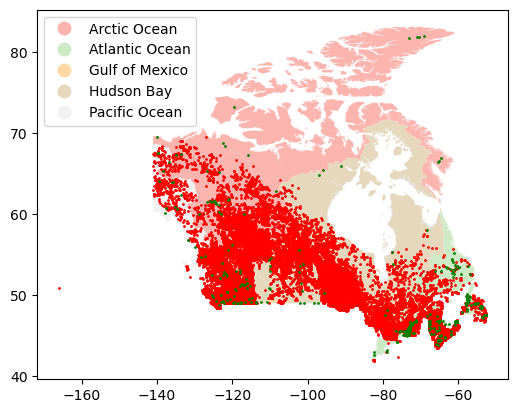

<Figure size 1600x800 with 0 Axes>

In [8]:
fig, ax = plt.subplots(1)
plt.figure(figsize =(16,8))
water_drainage_regions_gdf.plot(ax=ax, cmap ='Pastel1', column='ODA_Name', legend=True)
fire_point_data_gdf.plot(ax=ax, color='red', markersize=1, legend=True)
water_data_site_gdf.plot(ax=ax, color='green', markersize=1, legend=True )
# ax.legend(loc='upper right')

### The intersection with the fire data takes ~ 5 - 10 minutes I will move it to a data prep step

In [9]:
#intersecting watershed and fire data to select ONLY fire data occuring in the Atlatic Ocean Watershed
myMainPlot_gdf = water_drainage_regions_gdf.loc[water_drainage_regions_gdf['ODA_Name']=='Atlantic Ocean'].overlay(fire_point_data_gdf, how='intersection')

C:\Users\johna\anaconda3\envs\dev\lib\site-packages\geopandas\geodataframe.py:2467: UserWarning: `keep_geom_type=True` in overlay resulted in 6147 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  return geopandas.overlay(


In [10]:
#limiting the selected drainage region to the Atlantic Region and renaming the colum for DR_Name
myRegion_gdf= water_drainage_regions_gdf.loc[water_drainage_regions_gdf['ODA_Name']=='Atlantic Ocean'][['DR_Name', 'geometry']]
myRegion_gdf = myRegion_gdf.rename(columns={'DR_Name': 'Drainage Basin'})

In [11]:
myMap  = myRegion_gdf.explore(column='Drainage Basin', cmap = 'Accent', tiles='CartoDB positron', tooltip=False)

folium.GeoJson(myMainPlot_gdf, name = "Forest Fires", overlay = True, style_function=lambda feature:{'fillColor':'red', 'opacity':.75, 'color':'red'}).add_to(myMap)
folium.GeoJson(water_data_site_gdf.loc[water_data_site_gdf['OCEANDA']=='ATLANTIC OCEAN'], name ="Montoring Sites", overlay = True, style_function=lambda feature:{'color':'green'}).add_to(myMap)
folium.TileLayer("OpenStreetMap").add_to(myMap)
folium.TileLayer("CartoDB positron").add_to(myMap)
folium.LayerControl().add_to(myMap)

myMap